In [2]:
# --- GRAD-CAM ANALYSIS NOTEBOOK ---
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import os
import glob
import random
from datetime import datetime
from tensorflow.keras.preprocessing import image

print("TensorFlow version:", tf.__version__)
print("Starting Grad-CAM analysis...")

TensorFlow version: 2.20.0
Starting Grad-CAM analysis...


In [3]:
def superimpose_heatmap_tf(original_img, heatmap, alpha=0.4):
    """Superimpose heatmap on original image using only TensorFlow operations."""
    # Convert heatmap to RGB using a colormap (simulate jet colormap)
    heatmap = np.uint8(255 * heatmap)
    
    # Create a simple colormap (red for high values, blue for low)
    heatmap_rgb = np.zeros((*heatmap.shape, 3), dtype=np.uint8)
    
    # Simple colormap: red -> yellow -> green -> blue
    heatmap_rgb[heatmap > 192, 0] = 255  # Red
    heatmap_rgb[heatmap > 192, 1] = heatmap[heatmap > 192] - 192
    heatmap_rgb[heatmap > 192, 2] = 0
    
    heatmap_rgb[(heatmap > 128) & (heatmap <= 192), 0] = 255
    heatmap_rgb[(heatmap > 128) & (heatmap <= 192), 1] = 255
    heatmap_rgb[(heatmap > 128) & (heatmap <= 192), 2] = 0
    
    heatmap_rgb[(heatmap > 64) & (heatmap <= 128), 0] = (heatmap[(heatmap > 64) & (heatmap <= 128)] - 64) * 4
    heatmap_rgb[(heatmap > 64) & (heatmap <= 128), 1] = 255
    heatmap_rgb[(heatmap > 64) & (heatmap <= 128), 2] = 0
    
    heatmap_rgb[heatmap <= 64, 0] = 0
    heatmap_rgb[heatmap <= 64, 1] = heatmap[heatmap <= 64] * 4
    heatmap_rgb[heatmap <= 64, 2] = 255
    
    # Resize heatmap to match original image using TensorFlow
    heatmap_rgb = tf.image.resize(
        heatmap_rgb[np.newaxis, ...], 
        [original_img.shape[0], original_img.shape[1]]
    ).numpy()[0].astype(np.uint8)
    
    # Superimpose the heatmap on original image
    superimposed_img = heatmap_rgb * alpha + original_img * (1 - alpha)
    superimposed_img = np.clip(superimposed_img, 0, 255).astype(np.uint8)
    
    return superimposed_img

def run_gradcam(model, img_path, target_size=(224, 224)):
    """Run Grad-CAM analysis on a single image"""
    try:
        # Load and preprocess image
        img = tf.keras.utils.load_img(img_path, target_size=target_size)
        img_array = tf.keras.utils.img_to_array(img)
        img_array = np.expand_dims(img_array, axis=0) / 255.0
        
        # Get prediction
        preds = model.predict(img_array, verbose=0)
        predicted_class = "RESTRICTED" if preds[0][0] > 0.5 else "UNRESTRICTED"
        confidence = preds[0][0] if preds[0][0] > 0.5 else 1 - preds[0][0]
        
        # Get base model and last conv layer
        base_model = model.get_layer('inception_v3')
        last_conv_layer = base_model.get_layer('mixed10')
        
        # Create model for Grad-CAM
        cam_model = tf.keras.models.Model(
            base_model.input,
            [last_conv_layer.output, base_model.output]
        )
        
        # Get augmented image (pass through data augmentation)
        augmented_img = model.layers[1](img_array, training=False)
        
        # Compute Grad-CAM
        with tf.GradientTape() as tape:
            conv_output, base_pred = cam_model(augmented_img)
            output_value = base_pred[0]
            
        grads = tape.gradient(output_value, conv_output)
        pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
        
        # Generate heatmap
        conv_output = conv_output[0]
        heatmap = tf.reduce_sum(tf.multiply(pooled_grads, conv_output), axis=-1)
        heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
        heatmap = tf.image.resize(heatmap[..., tf.newaxis], target_size).numpy().squeeze()
        
        # Prepare images for display
        original_img = (img_array[0] * 255).astype(np.uint8)
        superimposed_img = superimpose_heatmap_tf(original_img, heatmap)
        
        # Display results
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))
        
        axes[0].imshow(original_img / 255.0)
        axes[0].set_title(f'Original\\n{predicted_class} ({confidence:.2%})')
        axes[0].axis('off')
        
        axes[1].imshow(heatmap, cmap='jet')
        axes[1].set_title('Grad-CAM Heatmap')
        axes[1].axis('off')
        
        axes[2].imshow(superimposed_img / 255.0)
        axes[2].set_title('Superimposed')
        axes[2].axis('off')
        
        plt.tight_layout()
        plt.show()
        
        return heatmap, superimposed_img, predicted_class, confidence
        
    except Exception as e:
        print(f"❌ Grad-CAM failed for {img_path}: {e}")
        return None, None, None, None

In [4]:
# Load your best InceptionV3 model
model_path = "models/InceptionV3_best.keras"

if os.path.exists(model_path):
    print("Loading trained model...")
    model = tf.keras.models.load_model(model_path)
    print("✅ Model loaded successfully!")
else:
    print("❌ Model file not found. Please check the path.")
    print("Expected path:", model_path)
    print("Current working directory:", os.getcwd())
    model = None

Loading trained model...
✅ Model loaded successfully!


In [5]:
# Find test images from test/restricted and test/unrestricted folders
test_images = []
search_paths = [
    "test/restricted/*.jpg",
    "test/unrestricted/*.jpg"
]

for path_pattern in search_paths:
    found_images = glob.glob(path_pattern)
    test_images.extend(found_images)

# Remove duplicates and display
test_images = list(set(test_images))

if test_images:
    print("✅ Found test images:")
    for img_path in test_images[:10]:
        print(f"  📄 {img_path}")
    if len(test_images) > 10:
        print(f"  ... and {len(test_images) - 10} more")
else:
    print("❌ No test images found. Please check the paths.")
    print("Searched in:", search_paths)

✅ Found test images:
  📄 test/restricted\staffordshire_bullterrier_151.jpg
  📄 test/restricted\german_shepherd_142.jpg
  📄 test/unrestricted\sealyham_terrier_007.jpg
  📄 test/restricted\staffordshire_bullterrier_153.jpg
  📄 test/unrestricted\beagle_007.jpg
  📄 test/unrestricted\great_dane_007.jpg
  📄 test/unrestricted\pomeranian_007.jpg
  📄 test/unrestricted\bouvier_des_flandres_007.jpg
  📄 test/restricted\staffordshire_bullterrier_142.jpg
  📄 test/restricted\german_shepherd_131.jpg
  ... and 227 more


In [6]:
# Separate images by class
restricted_images = [img for img in test_images if "restricted" in img]
unrestricted_images = [img for img in test_images if "unrestricted" in img]

print(f"Found {len(restricted_images)} restricted images")
print(f"Found {len(unrestricted_images)} unrestricted images")

# Sample 6 from each class (or all if less than 6)
sample_restricted = random.sample(restricted_images, min(6, len(restricted_images)))
sample_unrestricted = random.sample(unrestricted_images, min(6, len(unrestricted_images)))

# Combine the samples
sampled_images = sample_restricted + sample_unrestricted

print(f"\n📊 Sampled {len(sample_restricted)} restricted + {len(sample_unrestricted)} unrestricted = {len(sampled_images)} total images")
for img_path in sampled_images:
    class_label = "RESTRICTED" if "restricted" in img_path else "UNRESTRICTED"
    print(f"  {class_label}: {os.path.basename(img_path)}")

Found 237 restricted images
Found 115 unrestricted images

📊 Sampled 6 restricted + 6 unrestricted = 12 total images
  RESTRICTED: rottweiler_150.jpg
  RESTRICTED: border_terrier_007.jpg
  RESTRICTED: staffordshire_bullterrier_139.jpg
  RESTRICTED: beagle_007.jpg
  RESTRICTED: german_shepherd_145.jpg
  RESTRICTED: clumber_007.jpg
  RESTRICTED: english_foxhound_007.jpg
  RESTRICTED: scotch_terrier_007.jpg
  RESTRICTED: soft-coated_wheaten_terrier_007.jpg
  RESTRICTED: leonberg_007.jpg
  RESTRICTED: norwich_terrier_007.jpg
  RESTRICTED: tibetan_mastiff_007.jpg


🔍 Running Grad-CAM on 12 sampled images...

1/12: RESTRICTED - rottweiler_150.jpg


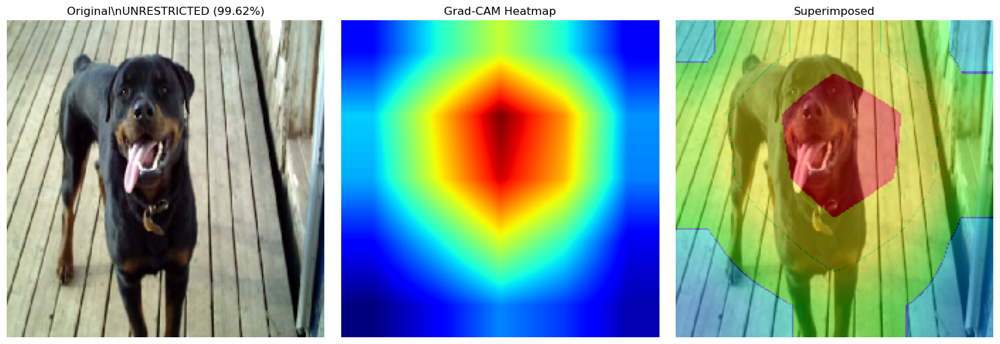

✅ Analysis complete: UNRESTRICTED (99.62% confidence)

2/12: RESTRICTED - border_terrier_007.jpg


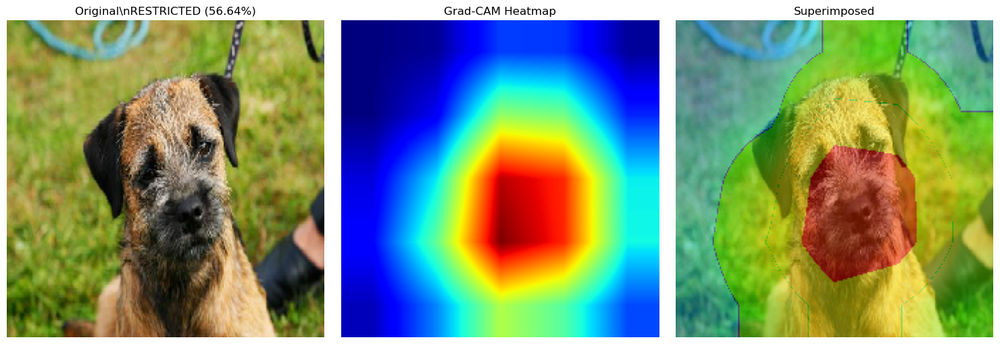

✅ Analysis complete: RESTRICTED (56.64% confidence)

3/12: RESTRICTED - staffordshire_bullterrier_139.jpg


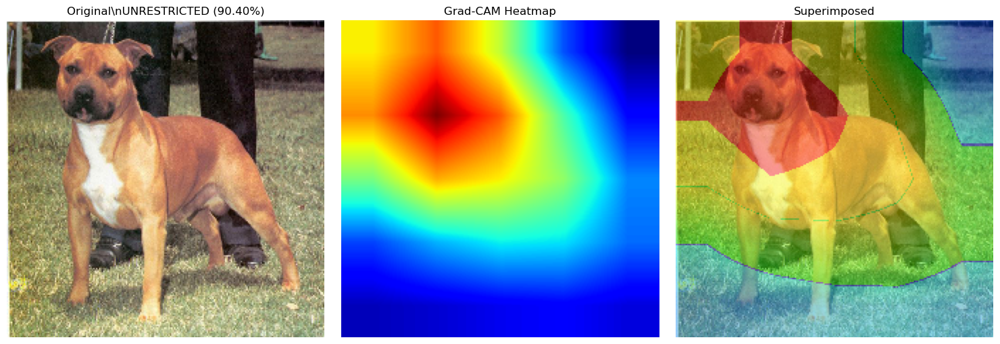

✅ Analysis complete: UNRESTRICTED (90.40% confidence)

4/12: RESTRICTED - beagle_007.jpg


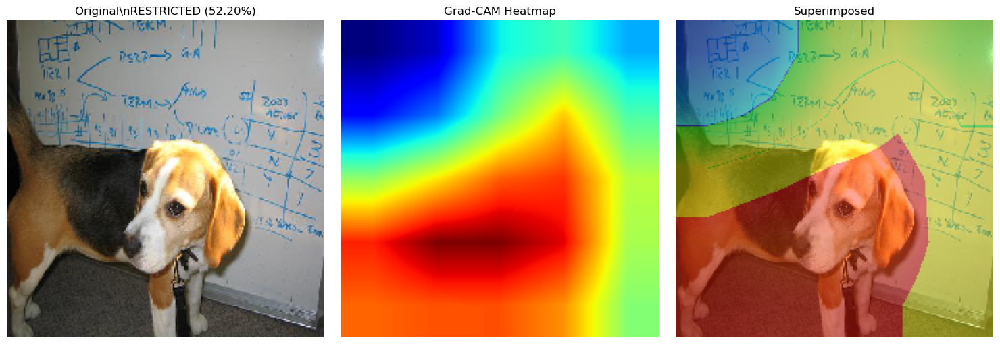

✅ Analysis complete: RESTRICTED (52.20% confidence)

5/12: RESTRICTED - german_shepherd_145.jpg


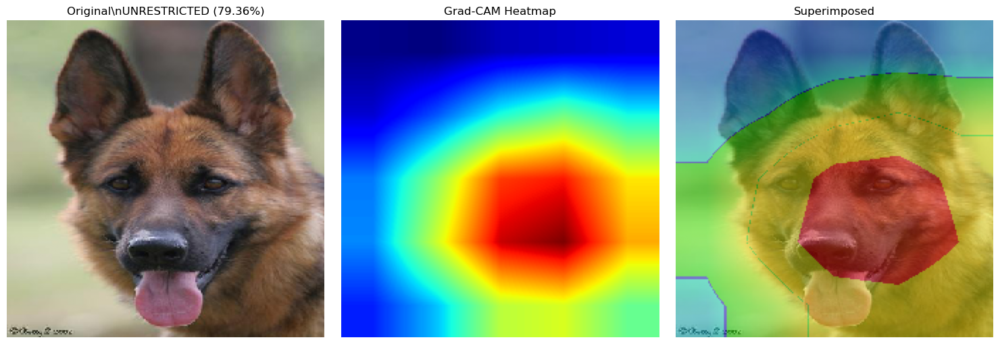

✅ Analysis complete: UNRESTRICTED (79.36% confidence)

6/12: RESTRICTED - clumber_007.jpg


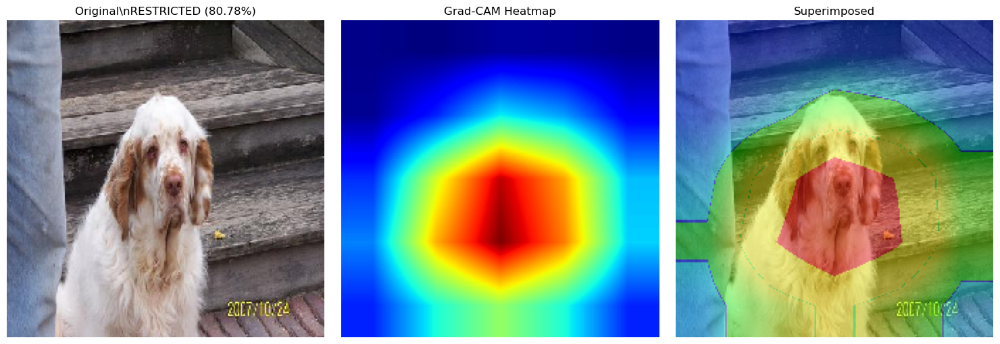

✅ Analysis complete: RESTRICTED (80.78% confidence)

7/12: RESTRICTED - english_foxhound_007.jpg


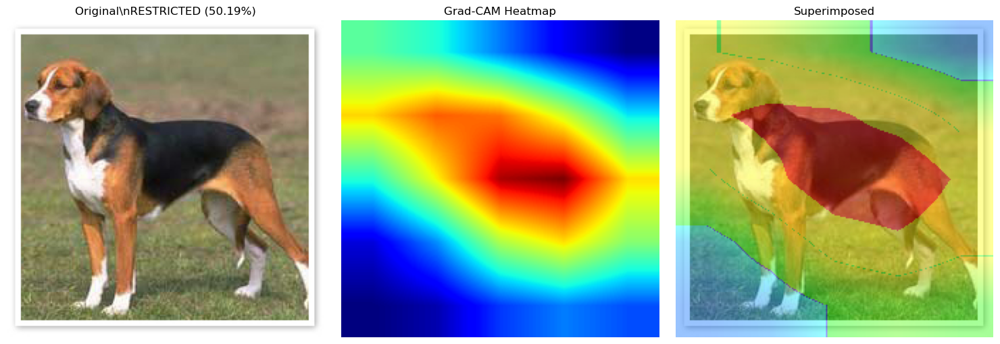

✅ Analysis complete: RESTRICTED (50.19% confidence)

8/12: RESTRICTED - scotch_terrier_007.jpg


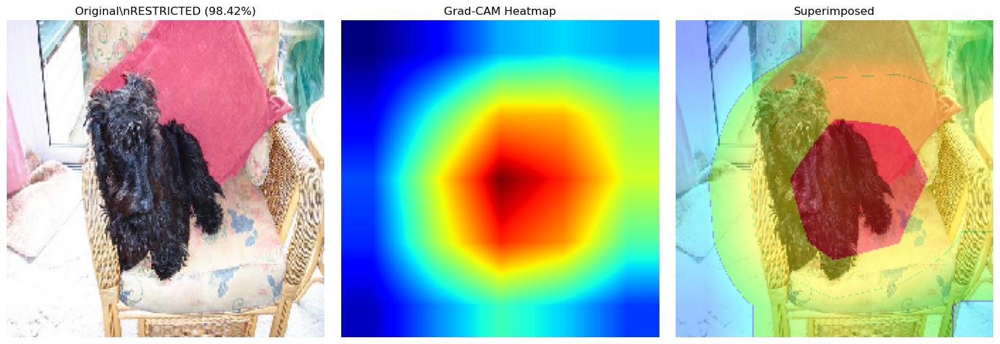

✅ Analysis complete: RESTRICTED (98.42% confidence)

9/12: RESTRICTED - soft-coated_wheaten_terrier_007.jpg


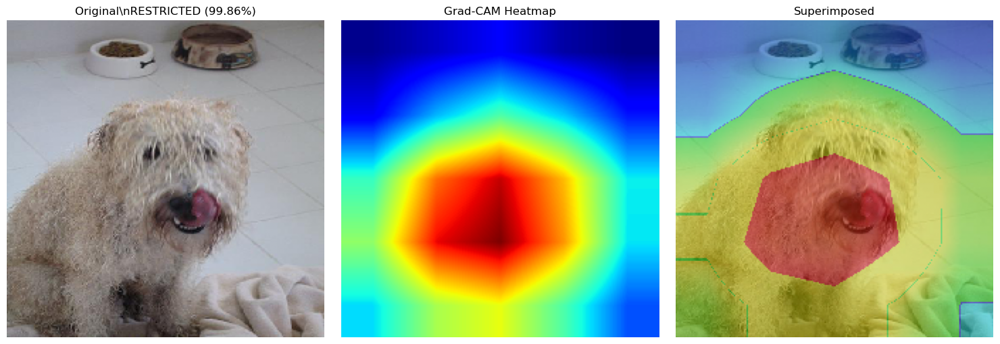

✅ Analysis complete: RESTRICTED (99.86% confidence)

10/12: RESTRICTED - leonberg_007.jpg


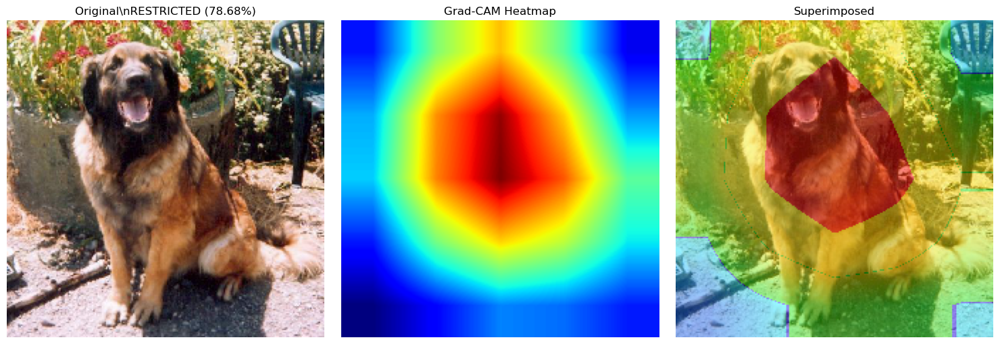

✅ Analysis complete: RESTRICTED (78.68% confidence)

11/12: RESTRICTED - norwich_terrier_007.jpg


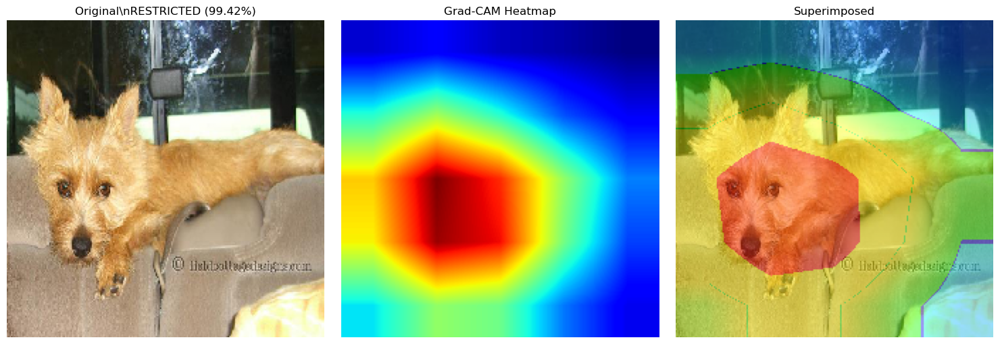

✅ Analysis complete: RESTRICTED (99.42% confidence)

12/12: RESTRICTED - tibetan_mastiff_007.jpg


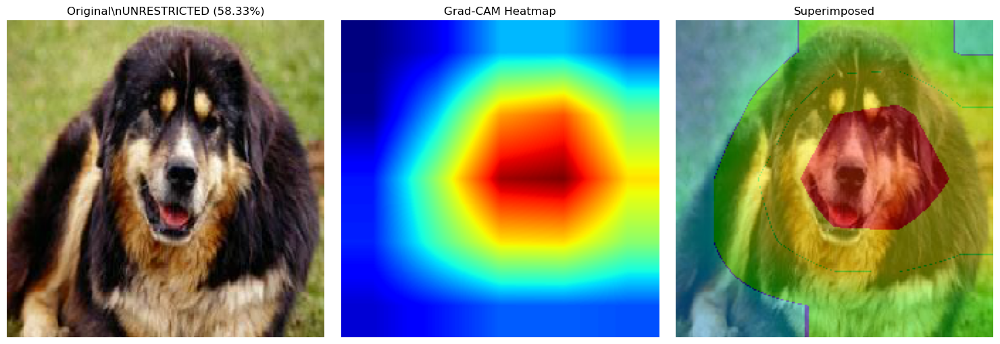

✅ Analysis complete: UNRESTRICTED (58.33% confidence)

🎉 Grad-CAM analysis complete on all sampled images!


In [7]:
# Cell 6: Run Grad-CAM on Sampled Images

if sampled_images and model is not None:
    print(f"🔍 Running Grad-CAM on {len(sampled_images)} sampled images...")
    
    for i, img_path in enumerate(sampled_images):
        class_label = "RESTRICTED" if "restricted" in img_path else "UNRESTRICTED"
        print(f"\n{'='*60}")
        print(f"{i+1}/{len(sampled_images)}: {class_label} - {os.path.basename(img_path)}")
        print(f"{'='*60}")
        
        heatmap, superimposed, pred_class, confidence = run_gradcam(model, img_path)
        
        if heatmap is not None:
            print(f"✅ Analysis complete: {pred_class} ({confidence:.2%} confidence)")
        else:
            print("❌ Analysis failed")
    
    print("\n🎉 Grad-CAM analysis complete on all sampled images!")
else:
    print("❌ Cannot run Grad-CAM. Check if model and test images are available.")


💾 Saving Grad-CAM results for 12 images...


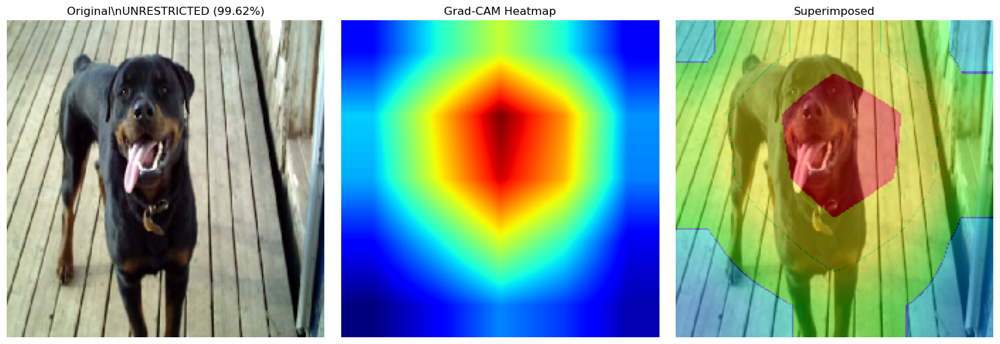

✅ Saved: restricted/rottweiler_150_*.png


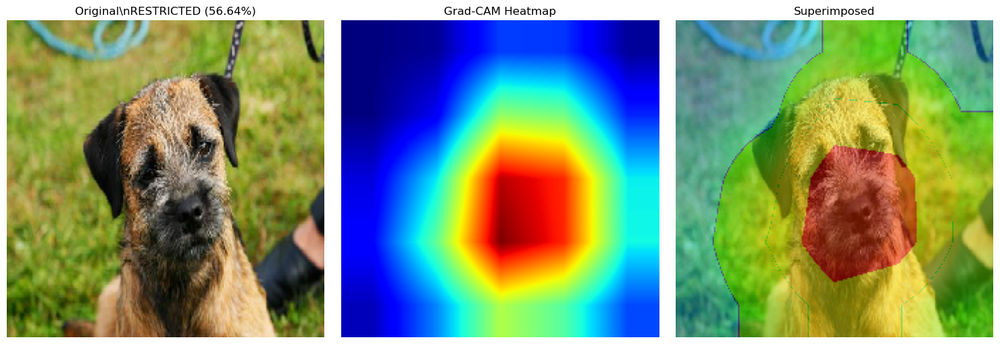

✅ Saved: restricted/border_terrier_007_*.png


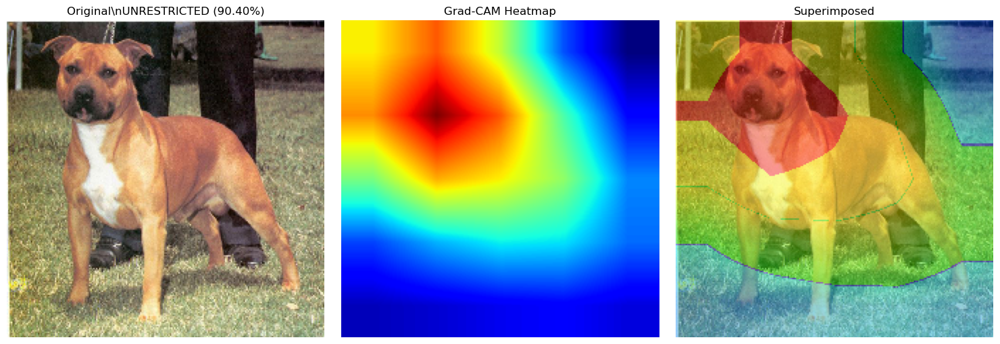

✅ Saved: restricted/staffordshire_bullterrier_139_*.png


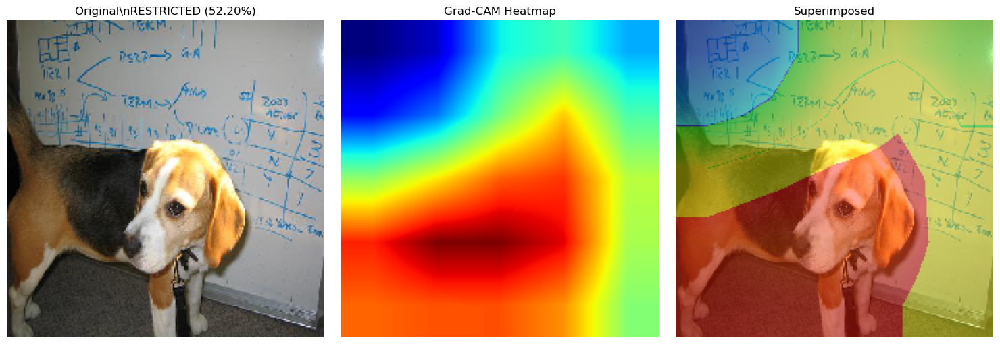

✅ Saved: restricted/beagle_007_*.png


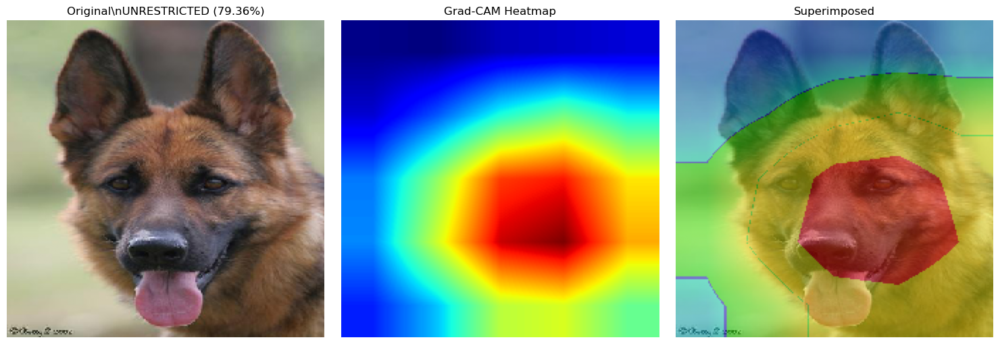

✅ Saved: restricted/german_shepherd_145_*.png


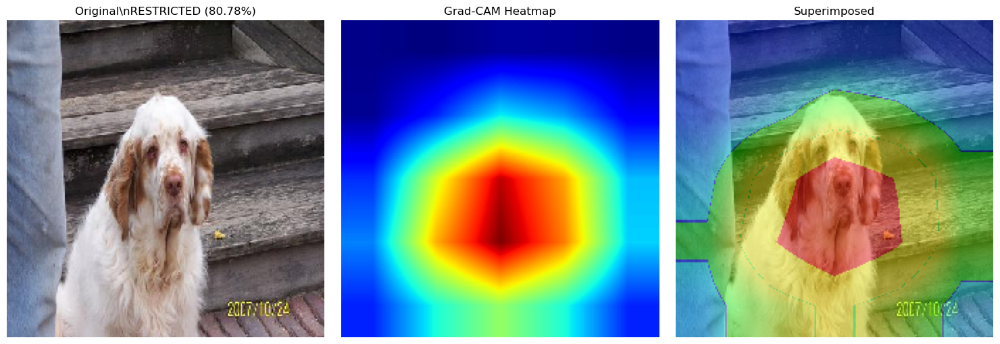

✅ Saved: restricted/clumber_007_*.png


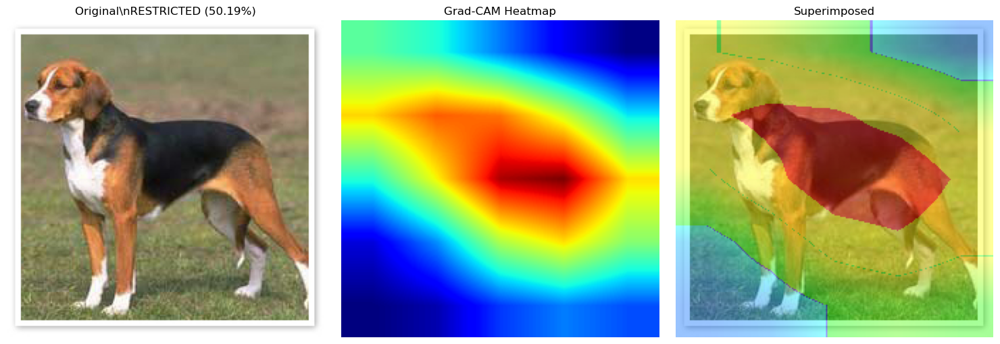

✅ Saved: restricted/english_foxhound_007_*.png


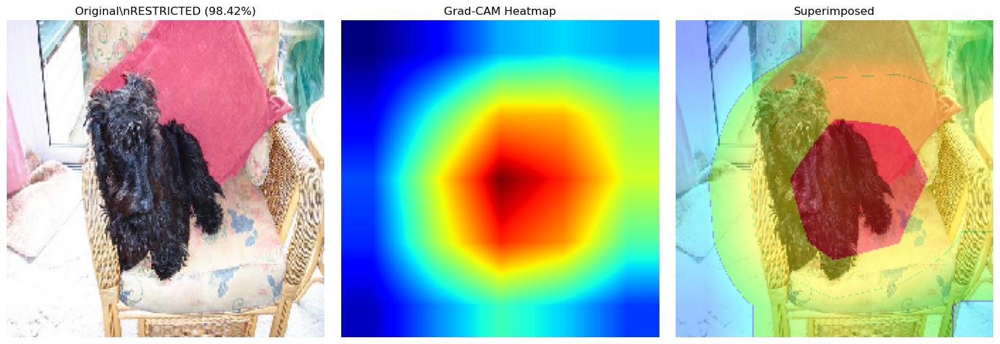

✅ Saved: restricted/scotch_terrier_007_*.png


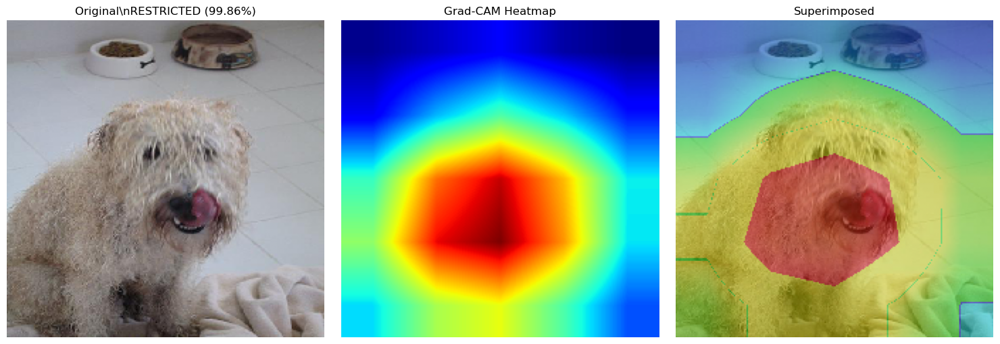

✅ Saved: restricted/soft-coated_wheaten_terrier_007_*.png


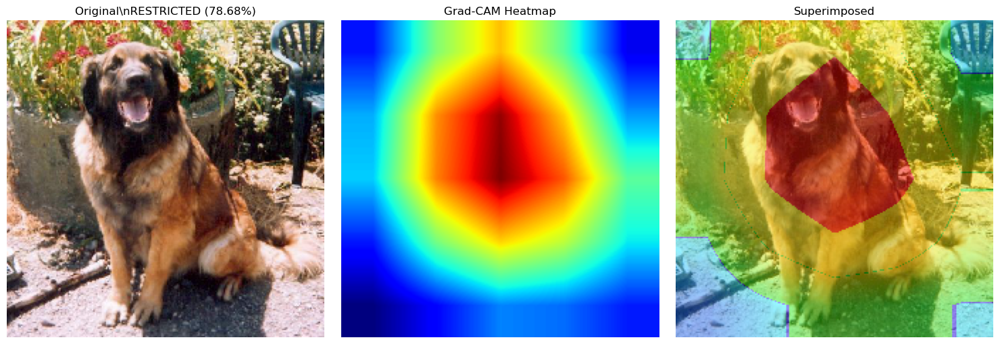

✅ Saved: restricted/leonberg_007_*.png


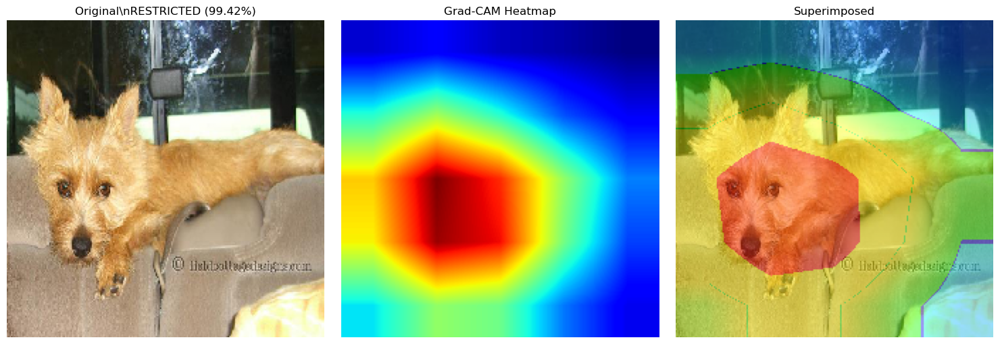

✅ Saved: restricted/norwich_terrier_007_*.png


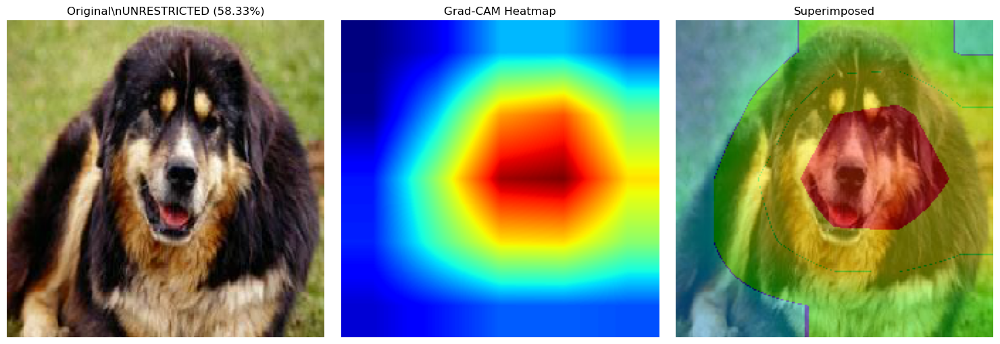

✅ Saved: restricted/tibetan_mastiff_007_*.png

🎉 Successfully saved 12/12 images
📁 Results saved in 'gradcam_results/' folder


In [8]:
def save_gradcam_results(model, img_path, output_dir="gradcam_results", target_size=(224, 224)):
    """Run Grad-CAM and save all results"""
    try:
        # Create output directory if it doesn't exist
        os.makedirs(output_dir, exist_ok=True)
        
        # Get image name for saving
        img_name = os.path.basename(img_path).split('.')[0]
        class_folder = "restricted" if "restricted" in img_path else "unrestricted"
        class_dir = os.path.join(output_dir, class_folder)
        os.makedirs(class_dir, exist_ok=True)
        
        # Run Grad-CAM
        heatmap, superimposed, pred_class, confidence = run_gradcam(model, img_path)
        
        if heatmap is None:
            return False
            
        # Load original image for saving
        img = tf.keras.utils.load_img(img_path, target_size=target_size)
        img_array = tf.keras.utils.img_to_array(img)
        img_array = np.expand_dims(img_array, axis=0) / 255.0
        original_img = (img_array[0] * 255).astype(np.uint8)
        
        # Save all images
        # 1. Original image
        original_path = os.path.join(class_dir, f"{img_name}_original.png")
        plt.imsave(original_path, original_img / 255.0)
        
        # 2. Heatmap only
        heatmap_path = os.path.join(class_dir, f"{img_name}_heatmap.png")
        plt.imsave(heatmap_path, heatmap, cmap='jet')
        
        # 3. Superimposed image
        superimposed_path = os.path.join(class_dir, f"{img_name}_superimposed.png")
        plt.imsave(superimposed_path, superimposed / 255.0)
        
        # 4. Combined comparison image
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))
        axes[0].imshow(original_img / 255.0)
        axes[0].set_title(f'Original\\n{pred_class} ({confidence:.2%})')
        axes[0].axis('off')
        
        axes[1].imshow(heatmap, cmap='jet')
        axes[1].set_title('Heatmap')
        axes[1].axis('off')
        
        axes[2].imshow(superimposed / 255.0)
        axes[2].set_title('Superimposed')
        axes[2].axis('off')
        
        combined_path = os.path.join(class_dir, f"{img_name}_combined.png")
        plt.savefig(combined_path, bbox_inches='tight', dpi=300)
        plt.close()
        
        print(f"✅ Saved: {class_folder}/{img_name}_*.png")
        return True
        
    except Exception as e:
        print(f"❌ Error saving {img_path}: {e}")
        return False

# Save results for all sampled images
if sampled_images and model is not None:
    print(f"\n💾 Saving Grad-CAM results for {len(sampled_images)} images...")
    
    success_count = 0
    for img_path in sampled_images:
        if save_gradcam_results(model, img_path):
            success_count += 1
    
    print(f"\n🎉 Successfully saved {success_count}/{len(sampled_images)} images")
    print(f"📁 Results saved in 'gradcam_results/' folder")